https://github.com/Toblerity/Fiona/issues/944

In [8]:
import fiona

In [9]:
import matplotlib.pyplot as plt
from gerrychain import (GeographicPartition, Partition, Graph, MarkovChain,
                        proposals, updaters, constraints, accept, Election)
from gerrychain.proposals import recom
from functools import partial
import pandas

In [10]:
import maup
import numpy as np
import geopandas
import matplotlib.pyplot as plt
from gerrychain import (GeographicPartition, Partition, Graph, MarkovChain,
                        proposals, updaters, constraints, accept, Election)
from gerrychain.updaters import Tally, cut_edges, exterior_boundaries, exterior_boundaries_as_a_set
from networkx import is_connected, connected_components


In [11]:
graph = Graph.from_file("./GA_precincts.zip", ignore_errors=True)
precincts = geopandas.read_file("./GA_precincts.zip")

C:\Users\darre\anaconda3\envs\gerrychain\lib\site-packages\gerrychain\graph\graph.py:162: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  areas = df.geometry.area.to_dict()


In [12]:
components = list(connected_components(graph))
biggest_component_size = max(len(c) for c in components)
problem_components = [c for c in components if len(c) != biggest_component_size]
print(is_connected(graph))
for component in problem_components:
    for node in component:
        graph.remove_node(node)
print(is_connected(graph))

True
True


In [13]:
from gerrychain.constraints.contiguity import contiguous_components, contiguous
from gerrychain import Partition

In [14]:
election = Election("PRES16", {"Dem": "PRES16D", "Rep": "PRES16R"})

initial_partition = GeographicPartition(
    graph,
    assignment="CD",
    updaters={
        "cut_edges": cut_edges,
        "population": Tally("TOTPOP", alias="population"),
        "PRES16": election
    }
)

In [15]:
contiguous_components(initial_partition)

{'12': [<Graph [249 nodes, 645 edges]>],
 '10': [<Graph [210 nodes, 545 edges]>],
 '13': [<Graph [166 nodes, 410 edges]>],
 '03': [<Graph [190 nodes, 477 edges]>],
 '09': [<Graph [176 nodes, 458 edges]>],
 '04': [<Graph [166 nodes, 419 edges]>],
 '06': [<Graph [204 nodes, 531 edges]>],
 '07': [<Graph [121 nodes, 288 edges]>],
 '05': [<Graph [235 nodes, 615 edges]>],
 '14': [<Graph [147 nodes, 375 edges]>],
 '02': [<Graph [221 nodes, 569 edges]>],
 '08': [<Graph [211 nodes, 514 edges]>],
 '01': [<Graph [227 nodes, 601 edges]>],
 '11': [<Graph [141 nodes, 374 edges]>]}

Recreate the initial partition

In [16]:
contiguous_components(initial_partition)

{'12': [<Graph [249 nodes, 645 edges]>],
 '10': [<Graph [210 nodes, 545 edges]>],
 '13': [<Graph [166 nodes, 410 edges]>],
 '03': [<Graph [190 nodes, 477 edges]>],
 '09': [<Graph [176 nodes, 458 edges]>],
 '04': [<Graph [166 nodes, 419 edges]>],
 '06': [<Graph [204 nodes, 531 edges]>],
 '07': [<Graph [121 nodes, 288 edges]>],
 '05': [<Graph [235 nodes, 615 edges]>],
 '14': [<Graph [147 nodes, 375 edges]>],
 '02': [<Graph [221 nodes, 569 edges]>],
 '08': [<Graph [211 nodes, 514 edges]>],
 '01': [<Graph [227 nodes, 601 edges]>],
 '11': [<Graph [141 nodes, 374 edges]>]}

In [17]:
for district, pop in initial_partition["population"].items():
    print("District {}: {}".format(district, pop))

District 12: 694472
District 10: 686359
District 13: 702236
District 03: 692044
District 09: 693876
District 04: 692977
District 06: 697249
District 07: 688212
District 05: 684957
District 14: 692988
District 02: 693118
District 08: 696700
District 01: 688442
District 11: 684023


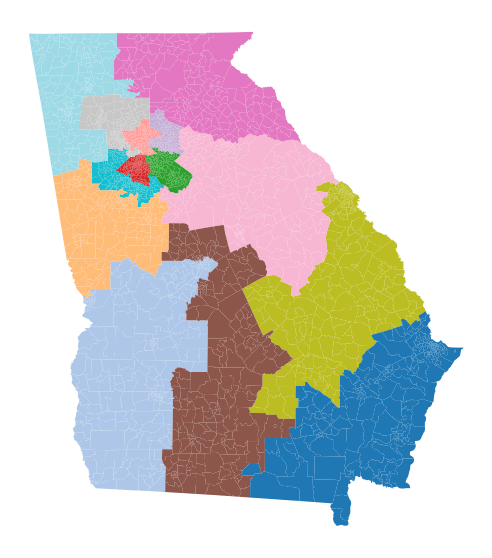

In [18]:
initial_partition.plot(figsize=(10, 10), cmap="tab20")
plt.axis('off')
plt.show()

In [19]:
sum_population = sum(initial_partition["population"].values())
ideal_population = sum_population / len(initial_partition)

# We use functools.partial to bind the extra parameters (pop_col, pop_target, epsilon, node_repeats)
# of the recom proposal.
proposal = partial(recom,
                   pop_col="TOTPOP",
                   pop_target=ideal_population,
                   epsilon=.05,
                   node_repeats=2
                  )

In [20]:
compactness_bound = constraints.UpperBound(
    lambda p: len(p["cut_edges"]),
    2*len(initial_partition["cut_edges"])
)

pop_constraint = constraints.within_percent_of_ideal_population(initial_partition, .05)

In [21]:
from gerrychain import MarkovChain
from gerrychain.constraints import single_flip_contiguous, contiguous
from gerrychain.proposals import propose_random_flip
from gerrychain.accept import always_accept
steps = 1000
chain = MarkovChain(
    proposal=proposal,
    constraints=[single_flip_contiguous, compactness_bound, pop_constraint],
    accept=always_accept,
    initial_state=initial_partition,
    total_steps=steps
)

In [22]:
def district_diff(partition1, partition2):
    percentage_change = []
    for (district1, graph1), (district2, graph2) in zip(contiguous_components(partition1).items(), contiguous_components(partition2).items()):
        if district1 == district2:
            set1 = set(graph1[0].nodes)
            set2 = set(graph2[0].nodes)
            if set1 != set2:
                set_diff1 = set1 - set2
                set_diff2 = set2 - set1
                diff = (len(set_diff1) + len(set_diff2))/len(set1)
                if diff > 1:
                    percentage_change.append(1)
                else:
                    percentage_change.append(diff)
            else:
                percentage_change.append(0)
    return percentage_change

In [ ]:
last1 = None
district_percent_change_per_partition = []
for partition in chain.with_progress_bar():
    district_percent_change_per_partition.append(district_diff(initial_partition, partition))
    last1 = partition

In [ ]:
import matplotlib.pyplot as plt

y = np.mean(district_percent_change_per_partition, axis=1)
plt.plot(y)

In [ ]:
last1.plot(figsize=(10, 10), cmap="tab20")
plt.axis('off')
plt.show()

In [ ]:
last1